In [1]:
%load_ext autoreload
%matplotlib inline
%autoreload 2

In [2]:
import os
os.chdir('/root/vast/joshua/')
print(os.getcwd())

xla_flags = os.environ.get("XLA_FLAGS", "")
xla_flags += " --xla_gpu_triton_gemm_any=True"
os.environ["XLA_FLAGS"] = xla_flags
os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"
os.environ["MUJOCO_GL"] = "egl"
os.environ["PYOPENGL_PLATFORM"] = "egl"


/root/vast/joshua


In [ ]:
import functools
import json
from datetime import datetime

from brax.training import types
import jax
from jax.experimental import checkify
import jax.numpy as jp
import matplotlib.pyplot as plt
import mediapy as media
import mujoco
# import wandb
# from brax.training.agents.ppo import networks as ppo_networks
from brax.training.agents.ppo import train as ppo
from etils import epath
from flax.training import orbax_utils
from IPython.display import clear_output, display
from IPython.display import Video

from matplotlib.animation import FFMpegWriter
from orbax import checkpoint as ocp
from tqdm import tqdm
import h5py

from mujoco_playground import locomotion, wrapper
from mujoco_playground.config import locomotion_params
from vnl_mjx.tasks.mouse import mouse_reach_josh

from vnl_mjx.tasks.mouse import mouse_reach
from ml_collections import config_dict


jax.config.update("jax_debug_nans", True)

# # Enable persistent compilation cache.
jax.config.update("jax_compilation_cache_dir", "/tmp/jax_cache")
jax.config.update("jax_persistent_cache_min_entry_size_bytes", -1)
jax.config.update("jax_persistent_cache_min_compile_time_secs", 0)


import jax.numpy as jnp
import numpy as np
from track_mjx.agent import checkpointing
from track_mjx.agent.mlp_ppo.intention_network import Decoder, Encoder
from track_mjx.analysis.rollout import create_environment
# from track_mjx.environment.wrappers import EvalClipResetWrapper
from track_mjx.analysis.render import render_rollout, display_video
from track_mjx.analysis.utils import save_to_h5py, load_from_h5py
from dm_control import mjcf as mjcf_dm
import mujoco
from tqdm import tqdm
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from PIL import Image
import multiprocessing as mp
import functools
from track_mjx.io import load

# from track_mjx.agent.mlp_ppo.intention_network import make_intention_policy
from track_mjx.agent.mlp_ppo.ppo_networks import make_intention_ppo_networks
from track_mjx.agent.mlp_ppo.intention_network import make_intention_policy
from track_mjx.agent.mlp_ppo import ppo_networks
from brax.training.acme import running_statistics
import h5py
import numpy as np
from tqdm import tqdm

from track_mjx.agent import checkpointing
from orbax import checkpoint as ocp
import yaml
import jax
from omegaconf import OmegaConf
from brax.training import distribution

jax.clear_caches()

In [10]:
yaml_config_path = "/root/vast/joshua/vnl-playground/vnl_mjx/config/arm_reach.yaml"

# 8 predefined targets
ckpt_path = '/root/vast/joshua/vnl-playground/model_checkpoints/250707_184643_bound_box_random_targets'

# ckpt_path = "/root/vast/joshua/vnl-playground/model_checkpoints/250707_044009"
# ckpt_path = "/root/vast/joshua/vnl-playground/model_checkpoints/250707_184643"

# Load your yaml config
with open(yaml_config_path, 'r') as f:
    yaml_config = yaml.safe_load(f)

# Create OmegaConf object from your config
cfg = OmegaConf.create(yaml_config)
cfg['network_config']['normalize_observations'] = True
print(cfg)

# Try to directly examine the checkpoint structure
mgr_options = ocp.CheckpointManagerOptions(
    create=False,
    step_prefix="PPONetwork"
)
ckpt_mgr = ocp.CheckpointManager(ckpt_path, options=mgr_options)
step = ckpt_mgr.latest_step()
print(f"Found checkpoint at step {step}")


try:
    saved_config = ckpt_mgr.restore(
        step,
        args=ocp.args.Composite(
            config=ocp.args.JsonRestore(),
        )
    )['config']
    print("Saved config found in ckpt mgr:")
    # if "network_config" in saved_config:
    #     for key, value in saved_config["network_config"].items():
    #         print(f"  {key}: {value}")
except Exception as e:
    raise AssertionError("Could not load saved config: {e}")


cfg["network_config"]["observation_size"] = 23
cfg["network_config"]["reference_obs_size"] = 15
cfg["network_config"]["action_size"] = 4

# Create an abstract policy structure and try to load
abstract_policy = checkpointing.make_abstract_policy(cfg)
policy = ckpt_mgr.restore(
    step, 
    args=ocp.args.Composite(
        policy=ocp.args.StandardRestore(abstract_policy, strict=True)
    )
)['policy']

print("\nSuccessfully loaded policy parameters")

{'env_config': {'env_name': 'mouse', 'task_name': 'arm-reach', 'walker_name': 'mouse', 'render_camera_name': 'my_camera', 'env_args': None}, 'network_config': {'arch_name': 'intention', 'encoder_layer_sizes': [512, 512, 512], 'decoder_layer_sizes': [512, 512, 512], 'critic_layer_sizes': [512, 512, 512], 'intention_size': 3, 'kl_schedule': False, 'kl_weight': 0, 'normalize_observations': True}, 'train_setup': {'agent_name': 'mouse', 'run_name': 'arm-reach', 'checkpoint_to_restore': None, 'freeze_decoder': False, 'checkpoint_max_to_keep': None, 'checkpoint_keep_period': None, 'eval_every': 50000000, 'reset_every': 100000000, 'train_config': {'episode_length': 300, 'num_envs': 8192, 'num_timesteps': 1000000000, 'batch_size': 256, 'num_minibatches': 32, 'num_updates_per_batch': 4, 'learning_rate': '1e-4', 'clipping_epsilon': 0.2, 'discounting': 0.97, 'action_repeat': 1, 'entropy_cost': '1e-4', 'reward_scaling': 1, 'normalize_observations': True, 'unroll_length': 20, 'seed': 0}}, 'logging_c

In [11]:
print(type(policy[0]))
print(type(policy[1]))

print(policy[1]['params'].keys())
# print(policy[1]['params']['decoder'])

<class 'brax.training.acme.running_statistics.RunningStatisticsState'>
<class 'dict'>
dict_keys(['decoder', 'encoder'])


In [12]:
# env = mouse_reach_josh.MouseEnv(target=jp.array([0.004, 0.012, -0.006]))
env = mouse_reach_josh.MouseEnv()
env.add_target(target=jp.array([0.004, 0.012, -0.006]))
state = env.reset(jax.random.PRNGKey(0))

# Basic dimensions
print(f"Actual observation shape: {state.obs.shape}")
print(f"Reference observation size: {state.info.get('reference_obs_size')}")
print(f"Action size: {env.action_size}")

jit_env_reset = jax.jit(env.reset)
jit_env_step = jax.jit(env.step)
# jit_apply = jax.jit(decoder.apply)


# this code is for imitation learning. i think this should honestly work as well..?
'''
policy_network = make_intention_policy(
    action_param_size=cfg.network_config.action_size * 2,  # For mean and std
    latent_size=3,  # Intention size 
    total_obs_size=cfg.network_config.observation_size,
    reference_obs_size=cfg.network_config.reference_obs_size,
    preprocess_observations_fn=running_statistics.normalize,
    encoder_hidden_layer_sizes=tuple(cfg.network_config.encoder_layer_sizes),
    decoder_hidden_layer_sizes=tuple(cfg.network_config.decoder_layer_sizes),
)
# type(policy_network) == networks.FeedForwardNetwork:
'''


ppo_network = make_intention_ppo_networks(
    observation_size = state.obs.shape[0] * 2,
    reference_obs_size = state.info.get('reference_obs_size'),
    action_size = env.action_size,
    preprocess_observations_fn = running_statistics.normalize,
    intention_latent_size = cfg['network_config']['intention_size'],
    encoder_hidden_layer_sizes = cfg['network_config']['encoder_layer_sizes'],
    decoder_hidden_layer_sizes = cfg['network_config']['decoder_layer_sizes'],
    value_hidden_layer_sizes = cfg['network_config']['critic_layer_sizes'],
)
# type(policy_network.value_network) == networks.FeedForwardNetwork
# type(policy_network) == PPOImitationNetworks


action_distribution = distribution.NormalTanhDistribution(event_size=cfg["network_config"]["action_size"])
def inference_fn(obs, key):
    # Run full network (normalizes obs internally)
    logits, mean, logvar, activations = ppo_network.policy_network.apply(policy[0], policy[1], obs, key, True)
    
    # Get deterministic action
    # action = action_distribution.mode(logits)

    # non deterministic action
    action = action_distribution.sample(logits, key)

    return action, mean, logvar, activations

jit_inference = jax.jit(inference_fn)

------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]


Actual observation shape: (23,)
Reference observation size: 15
Action size: 4


In [ ]:
def render_rollout(qposes_rollout: jnp.ndarray, target=None):
    xml_path = "/root/vast/joshua/vnl-playground/vnl_mjx/tasks/mouse/xmls/akira_torque.xml"
    
    spec = mujoco.MjSpec.from_string(epath.Path(xml_path).read_text())
    if target is not None:
        print(f"adding target at pos {target}")
        spec.worldbody.add_site(
            name = 'target',
            pos = target,
            size=[0.001, 0.001, 0.001],
            rgba=[0, 1, 0, 0.5],
        )
    # model = mujoco.MjModel.from_xml_path(arm_path)
    mj_model = spec.compile()

    # define solver
    mj_model.opt.solver = {
        "cg": mujoco.mjtSolver.mjSOL_CG,
        "newton": mujoco.mjtSolver.mjSOL_NEWTON,
    }["cg"]
    mj_model.opt.iterations = 6
    mj_model.opt.ls_iterations = 6
    mj_data = mujoco.MjData(mj_model)

    
    mujoco.mj_kinematics(mj_model, mj_data)
    renderer = mujoco.Renderer(mj_model, height=480, width=640)
    frames = []
    print("MuJoCo Rendering...")

    cam = mujoco.MjvCamera()
    mujoco.mjv_defaultCamera(cam)
    mujoco.mj_forward(mj_model, mj_data)

    cam.azimuth    =   0.0          # deg
    cam.elevation  = 0.0          # deg (downward)
    cam.distance   =  0.03445       # metres
    cam.lookat[:]  = (0.0015, 0.0040, -0.0015)

    for qpos in tqdm(qposes_rollout):
        mj_data.qpos = qpos
        mujoco.mj_forward(mj_model, mj_data)
        renderer.update_scene(mj_data, camera=cfg.env_config.render_camera_name)
        pixels1 = renderer.render()
        renderer.update_scene(mj_data, camera=cam)
        pixels2 = renderer.render()
        pixels = np.concatenate([pixels1, pixels2], axis=1)
        frames.append(pixels)
    return frames

In [14]:
def render_rollout_special(qposes_rollout: jnp.ndarray, eval_target=None):
    xml_path = "/root/vast/joshua/vnl-playground/vnl_mjx/tasks/mouse/xmls/akira_torque.xml"
    
    spec = mujoco.MjSpec.from_string(epath.Path(xml_path).read_text())

    # train_targets = [
    #     [0.004, 0.012, -0.006],
    #     [0.0025355, 0.012, -0.0024645],
    #     [-0.001, 0.012, -0.001],
    #     [-0.0045355, 0.012, -0.0024645],
    #     [-0.006, 0.012, -0.006],
    #     [-0.0045355, 0.012, -0.0095355],
    #     [-0.001, 0.012, -0.011],
    #     [0.0025355, 0.012, -0.0095355],
    # ]
    # for target in train_targets:
    #     if (jp.array(target) == eval_target).all(): continue
    #     spec.worldbody.add_site(
    #         # name = 'target',
    #         pos = target,
    #         size=[0.001, 0.001, 0.001],
    #         rgba=[0, 1, 0, 0.5],
    #     )

    # ADD BOUNDING BOX
    box = spec.worldbody.add_site(
        name = 'BOUNDING_BOX',
        type=mujoco.mjtGeom.mjGEOM_BOX,
        pos=[-0.001, 0.0115, -0.004],
        size=[0.009, 0.0035, 0.006],
        rgba=[1, 0, 0, 0.1],  # red, very transparent
    )

    if eval_target is not None:
        spec.worldbody.add_site(
            pos = eval_target,
            size=[0.001, 0.001, 0.001],
            rgba=[1, 0, 0, 0.5],
        )

    mj_model = spec.compile()

    # define solver
    mj_model.opt.solver = {
        "cg": mujoco.mjtSolver.mjSOL_CG,
        "newton": mujoco.mjtSolver.mjSOL_NEWTON,
    }["cg"]
    mj_model.opt.iterations = 6
    mj_model.opt.ls_iterations = 6
    mj_data = mujoco.MjData(mj_model)

    
    mujoco.mj_kinematics(mj_model, mj_data)
    renderer = mujoco.Renderer(mj_model, height=480, width=640)
    frames = []

    cam = mujoco.MjvCamera()
    mujoco.mjv_defaultCamera(cam)
    mujoco.mj_forward(mj_model, mj_data)

    cam.azimuth    =   240.0          # deg
    cam.elevation  =  -5.0          # deg (downward)
    cam.distance   =  0.03445       # metres
    cam.lookat[:]  = (0.0015, 0.0040, -0.0015)

    for qpos in qposes_rollout:
        mj_data.qpos = qpos
        mujoco.mj_forward(mj_model, mj_data)
        renderer.update_scene(mj_data, camera=cfg.env_config.render_camera_name)
        pixels1 = renderer.render()
        # renderer.update_scene(mj_data, camera=cam)
        renderer.update_scene(mj_data, camera='josh_cam')
        pixels2 = renderer.render()
        pixels = np.concatenate([pixels1, pixels2], axis=1)
        frames.append(pixels)
    return frames

In [15]:
# targets_eval = jp.array([
#     # [-0.001,  0.012, -0.006],
#     # [-0.001,  0.015, -0.006],
#     # [-0.001,  0.009, -0.006],
#     [-0.001,  0.012,  0.002],
#     [-0.001,  0.012, -0.012],
#     [ 0.008,  0.012, -0.006], # right side of arm (viewing from arm)
#     [-0.010,  0.012, -0.006], # left  side of arm (viewing from arm)
# ])

low  = jp.array([-0.010, 0.008, -0.012])
high = jp.array([ 0.008, 0.015,  0.002])

targets_eval = jax.random.uniform(
    jax.random.PRNGKey(0),
    shape=(5,3),
    minval=low,
    maxval=high,
    dtype=jp.float32
).tolist()

# Predefined targets rollouts

In [8]:
target = jp.array(
            [
                [0.004, 0.012, -0.006],
                [0.0025355, 0.012, -0.0024645],
                [-0.001, 0.012, -0.001],
                [-0.0045355, 0.012, -0.0024645],
                [-0.006, 0.012, -0.006],
                [-0.0045355, 0.012, -0.0095355],
                [-0.001, 0.012, -0.011],
                [0.0025355, 0.012, -0.0095355],
            ]
)[0]

In [ ]:
qposes_rollout = []
# actions_rollout = []
# rewards_rollout = []
# handp_rollout = []
# handv_rollout = []
# jointv_rollout = []

# # activation stuff
# decoders_rollout = []
# encoders_rollout = []
# intentions_rollout = []


rng = jax.random.PRNGKey(0)

frames = []
for target in targets_eval:
    rng, env_rng = jax.random.split(rng)

    env = mouse_reach_josh.MouseEnv()
    env.add_target(target)
    state = env.reset(env_rng)
    target = env.target
    qposes = []
    actions = []
    rewards = []
    handps = []
    handvs = []
    jointvs = []

    # activation stuff
    decoders = []
    encoders = []
    intentions = []


    for step in range(100):

        rng, step_rng = jax.random.split(rng)
        
        # Get action and track internal states
        action, mean, logvar, activation = jit_inference(state.obs, step_rng)
        
        # Store data
        qposes.append(state.data.qpos)
        # actions.append(action)
        # rewards.append(state.reward)
        # handps.append(state.info['hand_pos'])
        # handvs.append(state.info['hand_vel'])
        # jointvs.append(state.info['qvel'])

        # activation stuff
        decoder = [activation['decoder'][layer] for layer in activation['decoder'].keys()]
        
        # we won't be getting the last two layers of encoder, size=3 instead of 512 so can't conver to numpy array
        # encoder = [activation['encoder'][layer] for layer in activation['encoder'].keys()]
        
        '''
        encoder = [activation['encoder'][layer] for layer in ['layer_0', 'layer_1', 'layer_2']]
        intention = activation['intention']

        decoders.append(decoder)
        encoders.append(encoder)
        intentions.append(intention)
        '''

        
        # Step environment
        state = jit_env_step(state, action)

    qposes_rollout.append(qposes)
    # actions_rollout.append(actions)
    # rewards_rollout.append(rewards)
    # handp_rollout.append(handps)
    # handv_rollout.append(handvs)
    # jointv_rollout.append(jointvs)

    # # activation stuff
    # decoders_rollout.append(decoders)
    # encoders_rollout.append(encoders)
    # intentions_rollout.append(intentions)



    frame = render_rollout_special(qposes, eval_target=target)
    frames.append(frame)


# qposes_rollout = np.array(qposes_rollout)
# actions_rollout = np.array(actions_rollout)
# rewards_rollout = np.array(rewards_rollout)
# handp_rollout = np.array(handp_rollout)
# handv_rollout = np.array(handv_rollout)
# jointv_rollout = np.array(jointv_rollout)

# decoders_rollout = np.array(decoders_rollout)
# encoders_rollout = np.array(encoders_rollout)
# intentions_rollout = np.array(intentions_rollout)

frames = np.array(frames)
frames = frames.reshape(-1, *frames.shape[2:])
vid, anim = display_video(frames[:20], framerate=10)
vid

------------------------------------------------------------------
Env reset with target position [-0.0003916   0.01480343 -0.00337266]
------------------------------------------------------------------
Env reset with target position [ 0.00563921  0.01241652 -0.00913864]
------------------------------------------------------------------
Env reset with target position [ 0.00334788  0.00905184 -0.00896249]
------------------------------------------------------------------
Env reset with target position [-0.00415119  0.0131491  -0.00090452]
------------------------------------------------------------------
Env reset with target position [-0.00331296  0.00891437 -0.01132264]


In [23]:
vid, anim = display_video(frames, framerate=30)
vid

In [71]:
num = 7
writer = FFMpegWriter(fps=10, metadata=dict(artist='Track-MJX'), bitrate=5000) # type: ignore
filename = f'/root/vast/joshua/vnl-playground/videos/july10_meeting/pretained_targets_model_arm_reach_{num}.mp4'
anim.save(filename, writer=writer)
vid

# Saving data

In [18]:
os.path.exists('/root/vast/joshua/vnl-playground/data/predefined_targets_arm_reach.h5')

True

In [128]:
def save_data(filename, dataname, data):
    assert filename.endswith(".h5")
    
    with h5py.File(filename, 'a') as f:
        if dataname in f: raise AssertionError("dataset name already exists!")
        f.create_dataset(
            dataname,
            data=data,
        )

filename = '/root/vast/joshua/vnl-playground/data/predefined_targets_arm_reach.h5'
save_data(filename,dataname='qposes_rollout_7', data=qposes_rollout)
save_data(filename,dataname='actions_rollout_7', data=actions_rollout)
save_data(filename,dataname='rewards_rollout_7', data=rewards_rollout)
save_data(filename,dataname='handp_rollout_7', data=handp_rollout)
save_data(filename,dataname='handv_rollout_7', data=handv_rollout)
save_data(filename,dataname='jointv_rollout_7', data=jointv_rollout)
save_data(filename,dataname='decoders_rollout_7', data=decoders_rollout)
save_data(filename,dataname='encoders_rollout_7', data=encoders_rollout)
save_data(filename,dataname='intentions_rollout_7', data=intentions_rollout)

with h5py.File(filename, 'r') as f:
    print(f.keys())

# with h5py.File(filename, 'r') as f:
#     print(f['actions_rollout_0'].shape)

<KeysViewHDF5 ['actions_rollout_0', 'actions_rollout_1', 'actions_rollout_2', 'actions_rollout_3', 'actions_rollout_4', 'actions_rollout_5', 'actions_rollout_6', 'actions_rollout_7', 'decoders_rollout_0', 'decoders_rollout_1', 'decoders_rollout_2', 'decoders_rollout_3', 'decoders_rollout_4', 'decoders_rollout_5', 'decoders_rollout_6', 'decoders_rollout_7', 'encoders_rollout_0', 'encoders_rollout_1', 'encoders_rollout_2', 'encoders_rollout_3', 'encoders_rollout_4', 'encoders_rollout_5', 'encoders_rollout_6', 'encoders_rollout_7', 'handp_rollout_0', 'handp_rollout_1', 'handp_rollout_2', 'handp_rollout_3', 'handp_rollout_4', 'handp_rollout_5', 'handp_rollout_6', 'handp_rollout_7', 'handv_rollout_0', 'handv_rollout_1', 'handv_rollout_2', 'handv_rollout_3', 'handv_rollout_4', 'handv_rollout_5', 'handv_rollout_6', 'handv_rollout_7', 'intentions_rollout_0', 'intentions_rollout_1', 'intentions_rollout_2', 'intentions_rollout_3', 'intentions_rollout_4', 'intentions_rollout_5', 'intentions_rollo

In [4]:
from moviepy.editor import VideoFileClip

In [44]:
clip = VideoFileClip("vnl-playground/videos/july10_meeting/predefined_targets_model_intention_reach_0.mp4")
# clip = VideoFileClip("/root/vast/joshua/vnl-playground/videos/july10_meeting/pretained_targets_model_arm_reach_0.mp4")
clip.duration

2.0

# Bounding box random targets rollouts

In [ ]:
qposes_rollout = {}
actions_rollout = {}
activations_rollout = {}
rewards_rollout = {}
handp_rollout = {}
handv_rollout = {}
jointv_rollout = {}


# target = jp.array([-0.001, 0.012, -0.006])


env = mouse_reach_josh.MouseEnv()
rng = jax.random.PRNGKey(0)

frames = []
for i in range(10):
    rng, env_rng = jax.random.split(rng)

    state = env.reset(env_rng)
    target = env.target
    qposes = []
    actions = []
    activations = []
    rewards = []
    handps = []
    handvs = []
    jointvs = []


    for step in range(150):

        rng, step_rng = jax.random.split(rng)
        
        # Get action and track internal states
        action, mean, logvar, activation = jit_inference(state.obs, step_rng)
        
        # Store data
        qposes.append(state.data.qpos)
        actions.append(action)
        activations.append(activation)
        rewards.append(state.reward)
        handps.append(state.info['hand_pos'])
        handvs.append(state.info['hand_vel'])
        jointvs.append(state.info['qvel'])

        
        # Step environment
        state = jit_env_step(state, action)

    qposes_rollout[i] = qposes
    actions_rollout[i] = actions
    activations_rollout[i] = activations
    rewards_rollout[i] = rewards
    handp_rollout[i] = handps
    handv_rollout[i] = handvs
    jointv_rollout[i] = jointvs

    frame = render_rollout_special(qposes, eval_target=target)
    frames.append(frame)

frames = np.array(frames)
frames = frames.reshape(-1, *frames.shape[2:])
display_video(frames, framerate=60)

------------------------------------------------------------------
Env reset with target position [ 0.00570346  0.00877736 -0.00812087]
------------------------------------------------------------------
Env reset with target position [ 4.9038334e-03  1.1127673e-02 -6.1942264e-06]
------------------------------------------------------------------
Env reset with target position [ 0.00267693  0.01039146 -0.00787186]
------------------------------------------------------------------
Env reset with target position [0.00354252 0.01122201 0.00181197]
------------------------------------------------------------------
Env reset with target position [0.00380888 0.00974264 0.00182449]
------------------------------------------------------------------
Env reset with target position [-0.00143788  0.01475856  0.00028178]
------------------------------------------------------------------
Env reset with target position [ 0.00629368  0.00891782 -0.01151468]
---------------------------------------------

### ------- bounding box random target rollouts end -------

In [ ]:
# qposes_rollout actions_rollout activations_rollout rewards_rollout

type(activations_rollout[0])
activations_rollout[0][1]
print(activations_rollout[0][0].keys())
print(activations_rollout[0][0]['decoder'].keys())

dict_keys(['decoder', 'egocentric_obs', 'encoder', 'intention', 'traj_obs'])
dict_keys(['layer_0', 'layer_1', 'layer_2'])


# intention plot for task based

In [ ]:
from josh_helper import plotters_3D

In [ ]:
intentions = np.array([activations_rollout[0][i]['intention'] for i in range(150)])
intentions.shape

(150, 3)

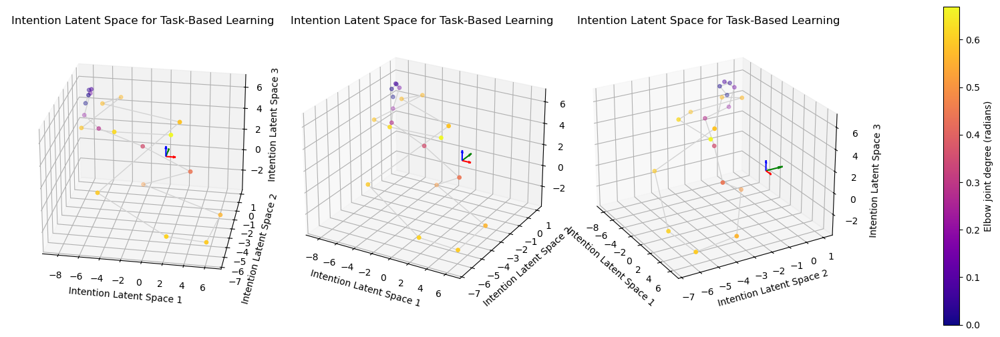

In [ ]:
# single reach plot
f = plotters_3D.plot_3d_single_clip(
    intentions,
    color_array=np.array(qposes_rollout[0])[:, 2],
    color_bar_label="Elbow joint degree (radians)",
    max_points=20,
    title = 'Intention Latent Space for Task-Based Learning',
    labels=[
        'Intention Latent Space 1',
        'Intention Latent Space 2',
        'Intention Latent Space 3'
        ],
    linewidth=1,
    scatter_ball_size=15,
    multiview=True
    )

In [ ]:
all_intentions = np.array([
    [activations_rollout[j][i]['intention'] for i in range(150)] for j in range(10)
])
all_intentions.shape

(10, 150, 3)

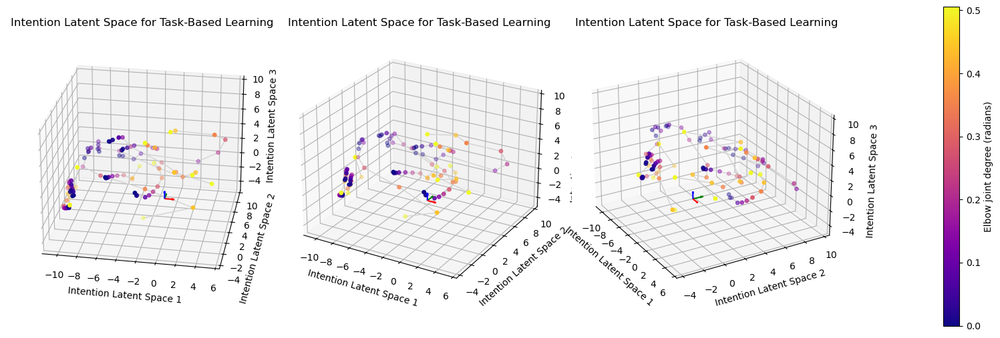

In [ ]:
# mutli reach plot
f = plotters_3D.plot_3d_multi_clip(
    all_intentions,
    color_array=np.array(qposes_rollout[0])[:, 2],
    color_bar_label="Elbow joint degree (radians)",
    max_points=10,
    title = 'Intention Latent Space for Task-Based Learning',
    labels=[
        'Intention Latent Space 1',
        'Intention Latent Space 2',
        'Intention Latent Space 3'
        ],
    linewidth=1,
    scatter_ball_size=15,
    multiview=True
    )

## --------------------------------------------------------------------

## helper stuff

In [ ]:
print(type(policy_network))
print(type(policy_network.policy_network))
print(type(policy_network.value_network))

In [ ]:
dir(state)
# type(state.obs)
state.info.keys()
state.metrics.keys()
# dir(env._mjx_model)
# env.mjx_model.qpos
state.data.qpos.shape

(4,)

In [ ]:
policy[1]['params']['decoder']['LayerNorm_0']['bias'].shape
# for key in cfg.network_config.keys():
#     print(key)

(512,)

# single pass for predefined target arm reaches

In [85]:
for num in range(8):
    target = jp.array(
                [
                    [0.004, 0.012, -0.006],
                    [0.0025355, 0.012, -0.0024645],
                    [-0.001, 0.012, -0.001],
                    [-0.0045355, 0.012, -0.0024645],
                    [-0.006, 0.012, -0.006],
                    [-0.0045355, 0.012, -0.0095355],
                    [-0.001, 0.012, -0.011],
                    [0.0025355, 0.012, -0.0095355],
                ]
    )[num]


    env = mouse_reach_josh.MouseEnv()
    env.add_target(target)
    rng = jax.random.PRNGKey(0)

    frames = []
    for _ in range(1):
        rng, env_rng = jax.random.split(rng)

        state = env.reset(env_rng)
        target = env.target
        qposes = []

        for step in range(100):

            rng, step_rng = jax.random.split(rng)
            
            # Get action and track internal states
            action, mean, logvar, activation = jit_inference(state.obs, step_rng)
            
            # Store data
            qposes.append(state.data.qpos)

            # Step environment
            state = jit_env_step(state, action)

        qposes_rollout.append(qposes)



        frame = render_rollout_special(qposes, eval_target=target)
        frames.append(frame)


    frames = np.array(frames)
    frames = frames.reshape(-1, *frames.shape[2:])
    vid, anim = display_video(frames[:20], framerate=10)

    writer = FFMpegWriter(fps=10, metadata=dict(artist='Track-MJX'), bitrate=5000) # type: ignore
    filename = f'/root/vast/joshua/vnl-playground/videos/july10_meeting/predefined_targets_model_arm_reach_{num}.mp4'
    anim.save(filename, writer=writer)
    # vid

------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012 

# JOSH CHECKPOINT MODEL CLASS

In [4]:
from josh_helper.ckpt_renderer import JoshCKPT_Model, h5Cooker
from josh_helper.plotters_3D import Josh_Plotter

In [16]:
jp = JoshCKPT_Model(
    ckpt_path='/root/vast/joshua/vnl-playground/model_checkpoints/250709_191739',
    predefined_targets=True,
)

train_targets = [
    [0.004, 0.012, -0.006],
    [0.0025355, 0.012, -0.0024645],
    [-0.001, 0.012, -0.001],
    [-0.0045355, 0.012, -0.0024645],
    [-0.006, 0.012, -0.006],
    [-0.0045355, 0.012, -0.0095355],
    [-0.001, 0.012, -0.011],
    [0.0025355, 0.012, -0.0095355],
]

for n, target in enumerate(train_targets):
    jp.eval_checkpoint(
        target=target,
        save_data=True,
        index_num=n,
        data_filename='vnl-playground/data/predefined_targets_arm_reach_DETERMINISTIC.h5',
        num_iters=10,
    )
    display(jp.display_video(fps=30))
    video_name = f'july10_meeting/predefined_targets_intentions_DETERMINISTIC_{n}.mp4'
    f = jp.plot_intention(max_length=20, filename=video_name)
    display(Video(f, embed=True))

    jp.intentions_rollout = None


Found checkpoint at step 18
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [ 0.004  0.012 -0.006]
----

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_0.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0024645]
------------------------------------------------------------------
En

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_1.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.001]
--------------------------------

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_2.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0024645]
------------------------------------------------------------------
En

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_3.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
------------------------------------------------------------------
Env reset with target position [-0.006  0.012 -0.006]
--------------------------------

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_4.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [-0.0045355  0.012     -0.0095355]
------------------------------------------------------------------
En

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_5.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
------------------------------------------------------------------
Env reset with target position [-0.001  0.012 -0.011]
--------------------------------

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_6.mp4
n frames is 20


------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
Env reset with target position [ 0.0025355  0.012     -0.0095355]
------------------------------------------------------------------
En

plotting and saving july10_meeting/predefined_targets_intentions_DETERMINISTIC_7.mp4
n frames is 20


In [18]:
jp = Josh_Plotter(
    data=cook.get_intentions(),
    color_array = cook.get_qposes()[:, :, 2],
    max_length = 10,
    color_bar_label="Elbow joint degree (radians)",
    title = 'Intention Latent Space for Task-Based Learning (Predefined Targets) DETERMINISTIC, length=10ms',
    labels=[
        'Intention Latent Space 1',
        'Intention Latent Space 2',
        'Intention Latent Space 3'
        ],
    linewidth=1,
    multiview=True,
    videoify = True,
    fps=10,
    ball_size=10,
    filename = f'/july10_meeting/pretrained_targets_model_intention_reach_{n}.mp4'
)
f = jp.plot()
Video(f, embed=True)

n frames is 10


In [9]:
low  = jp.array([-0.010, 0.008, -0.012])
high = jp.array([ 0.008, 0.015,  0.002])

sample_point = jax.random.uniform(
    jax.random.PRNGKey(0),
    shape=(5,3),
    minval=low,
    maxval=high,
    dtype=jp.float32
).tolist()
sample_point

[[-0.00039159972220659256, 0.014803427271544933, -0.0033726561814546585],
 [0.005639208480715752, 0.012416524812579155, -0.009138640947639942],
 [0.003347877413034439, 0.009051840752363205, -0.008962488733232021],
 [-0.004151192028075457, 0.013149104081094265, -0.000904519110918045],
 [-0.0033129570074379444, 0.008914370089769363, -0.011322643607854843]]